In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import geopandas as gpd
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.colors as colors
import matplotlib.patches as mpatches
from pandas import cut
from matplotlib import colormaps as cmap
import folium

%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 8)
plt.style.use("ggplot")

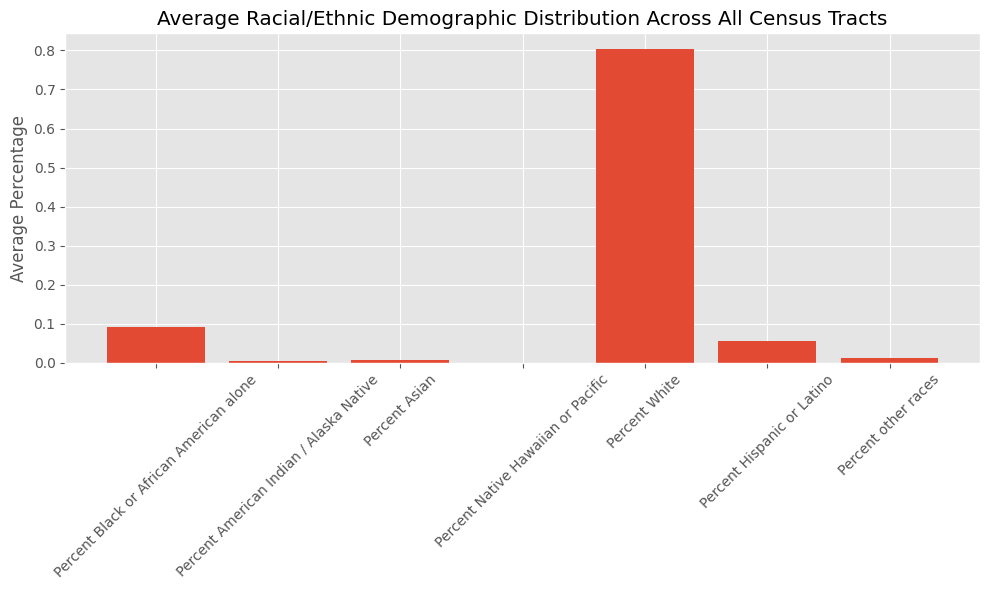

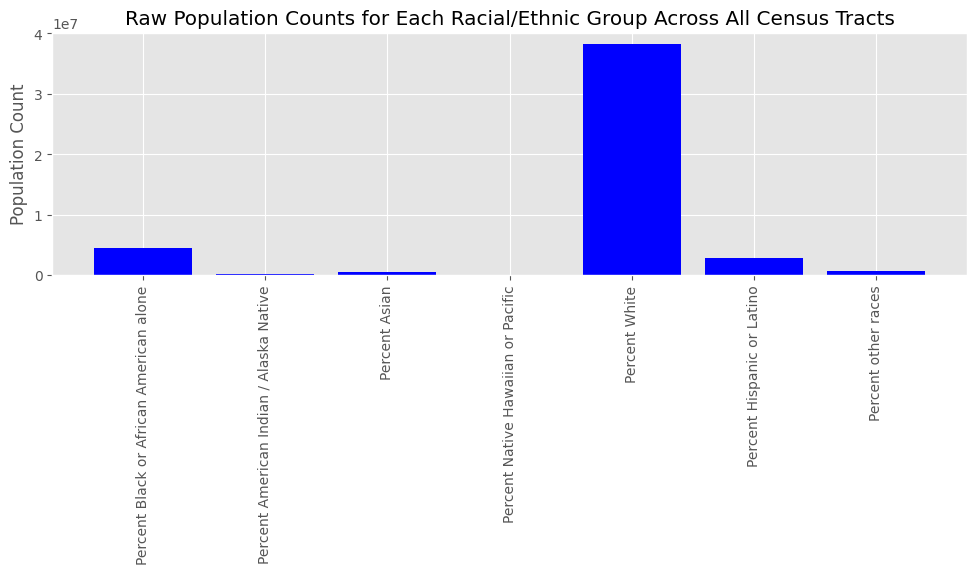

C:\Users\Kassidi\AppData\Local\Temp\ipykernel_31864\737022760.py:15: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  correlation_data = correlation_data.applymap(lambda x: 1 if x == True else (0 if x == False else x))


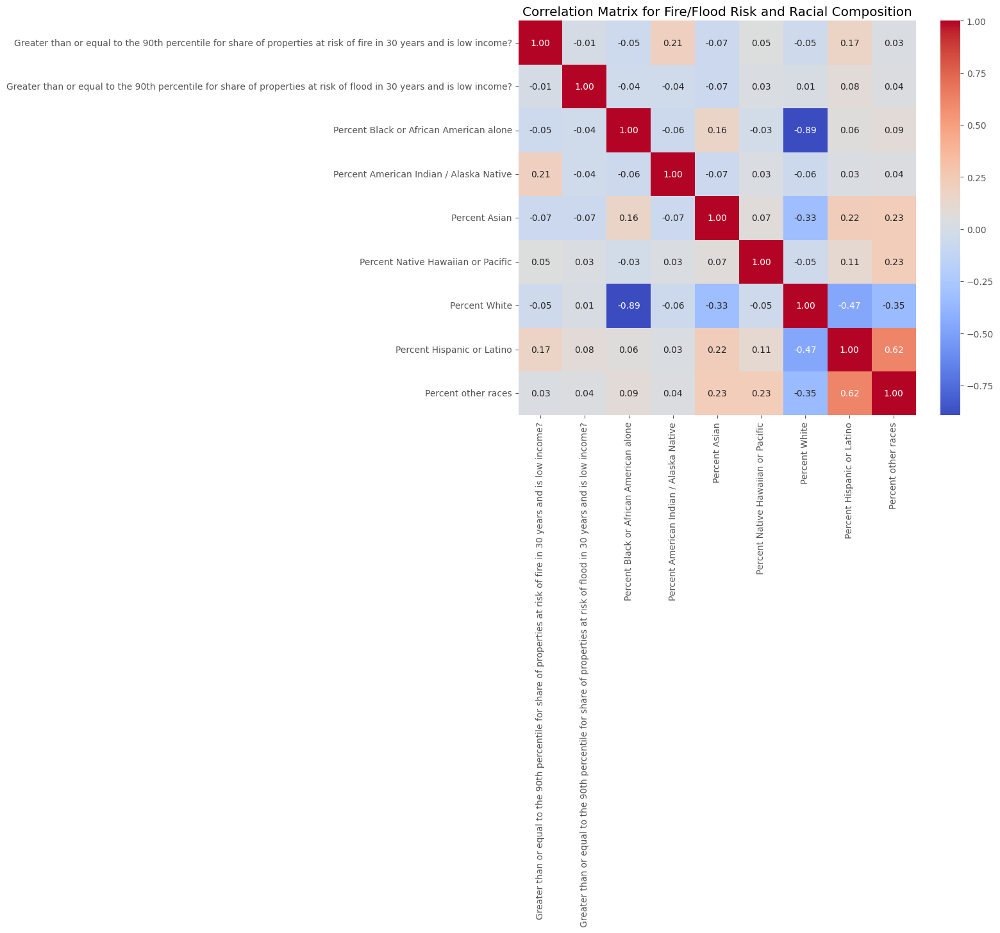

C:\Users\Kassidi\AppData\Local\Temp\ipykernel_31864\192254015.py:2: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  poverty_data = poverty_stats.applymap(lambda x: 1 if x is True else (0 if x is False else x))


       Census tract 2010 ID        County Name  Poverty Score
0              3.705706e+10    Davidson County       0.114636
1              4.703703e+10    Davidson County       0.165983
2              1.129044e+09  Washington County       0.265097
3              5.143011e+09  Washington County       0.092735
4              8.121924e+09  Washington County       0.037168
...                     ...                ...            ...
11797          3.711501e+10     Madison County       0.234910
11798          3.909704e+10     Madison County       0.046048
11799          4.711300e+10     Madison County       0.170405
11800          4.831300e+10     Madison County       0.079595
11801          5.111393e+10     Madison County       0.028036

[11802 rows x 3 columns]


In [4]:
%run poverty_analysis.ipynb

In [5]:
env_cols = [
    'Census tract 2010 ID', 
    'County Name', 
    'State/Territory',
    'Total population', 
    'Percent American Indian / Alaska Native', 
    'Percent Asian', 'Percent Black or African American alone', 
    'Percent Hispanic or Latino', 
    'Percent Native Hawaiian or Pacific',
    'Percent other races', 
    'Percent White',
    'Energy burden',
    'Energy burden (percentile)',
    'Percent pre-1960s housing (lead paint indicator)',
    'Percent pre-1960s housing (lead paint indicator) (percentile)',
    'PM2.5 in the air',
    'PM2.5 in the air (percentile)',
    'Proximity to hazardous waste sites (percentile)',
    'Share of properties at risk of flood in 30 years (percentile)',
    'Proximity to Risk Management Plan (RMP) facilities (percentile)',
    'Share of properties at risk of fire in 30 years (percentile)'
]   

env_stats = pd.read_csv(r"C:\\New_499_Code\\499_Cleaned_Abbreviated_CEJST_Disadvantaged_Communities_Data.csv", usecols=env_cols)

In [6]:
#aggregate the data to the county level 
env_stats = env_stats.groupby(['County Name', 'State/Territory']).mean().reset_index()

env_stats.head(2)

,County Name,State/Territory,Census tract 2010 ID,Percent Black or African American alone,Percent American Indian / Alaska Native,Percent Asian,Percent Native Hawaiian or Pacific,Percent White,Percent Hispanic or Latino,Percent other races,...,Share of properties at risk of flood in 30 years (percentile),Share of properties at risk of fire in 30 years (percentile),Energy burden (percentile),Energy burden,PM2.5 in the air (percentile),PM2.5 in the air,Percent pre-1960s housing (lead paint indicator) (percentile),Percent pre-1960s housing (lead paint indicator),Proximity to hazardous waste sites (percentile),Proximity to Risk Management Plan (RMP) facilities (percentile)
0,Abbeville County,South Carolina,4.500195e+10,0.256667,0.000000,0.001667,0.0,0.698333,0.008333,0.000000,...,29.833333,45.5,90.666667,5.166667,35.666667,8.076667,52.500000,27.166667,25.666667,28.000000
1,Acadia Parish,Louisiana,2.200196e+10,0.171667,0.000833,0.000000,0.0,0.769167,0.020833,0.001667,...,84.666667,33.0,69.666667,3.583333,62.416667,8.996667,47.166667,23.083333,19.416667,51.583333


In [8]:
CEJST_shapefile_path = r"C:\New_499_Code\assets\cb_2021_us_tract_500k\cb_2021_us_tract_500k.shp"
CEJST_Shapefile = gpd.read_file(CEJST_shapefile_path)
CEJST_Shapefile.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
0,13,163,960300,1400000US13163960300,13163960300,9603,Census Tract 9603,GA,Jefferson County,Georgia,CT,564728206,4845400,"POLYGON ((-82.66192 33.12633, -82.65194 33.126..."
1,37,109,071201,1400000US37109071201,37109071201,712.01,Census Tract 712.01,NC,Lincoln County,North Carolina,CT,5976613,6611763,"POLYGON ((-80.99344 35.47878, -80.99142 35.480..."


In [9]:
# Filter the GeoDataFrame because it takes 20 minutes to run otherwise
filtered_CEJST_Shapefile = CEJST_Shapefile[CEJST_Shapefile['STATE_NAME'].isin(['Tennessee'])]
filtered_CEJST_Shapefile.head(2)

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,LSAD,ALAND,AWATER,geometry
361,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,CT,2272173,0,"POLYGON ((-86.71746 36.12302, -86.71703 36.123..."
542,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,CT,2315123,0,"POLYGON ((-82.36523 36.30877, -82.36357 36.309..."


In [10]:
#merge the environmental data with the shapefile, keep all columns 
env_stats = filtered_CEJST_Shapefile.merge(env_stats, left_on='NAMELSADCO', right_on='County Name', how='left')
env_stats.head(2)


,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,Share of properties at risk of flood in 30 years (percentile),Share of properties at risk of fire in 30 years (percentile),Energy burden (percentile),Energy burden,PM2.5 in the air (percentile),PM2.5 in the air,Percent pre-1960s housing (lead paint indicator) (percentile),Percent pre-1960s housing (lead paint indicator),Proximity to hazardous waste sites (percentile),Proximity to Risk Management Plan (RMP) facilities (percentile)
0,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,39.764706,35.029412,58.558824,3.029412,56.676471,8.801176,40.735294,18.823529,43.058824,43.264706
1,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,56.086957,33.000000,43.734177,2.354430,47.496894,8.497267,43.211180,23.608696,44.583851,58.142857


In [11]:
#env_stats.columns

In [12]:
# Convert relevant columns to numeric types
env_stats['Energy burden'] = pd.to_numeric(env_stats['Energy burden'], errors='coerce')
env_stats['Percent American Indian / Alaska Native'] = pd.to_numeric(env_stats['Percent American Indian / Alaska Native'], errors='coerce')
env_stats['Percent Asian'] = pd.to_numeric(env_stats['Percent Asian'], errors='coerce')
env_stats['Percent Black or African American alone'] = pd.to_numeric(env_stats['Percent Black or African American alone'], errors='coerce')
env_stats['Percent Hispanic or Latino'] = pd.to_numeric(env_stats['Percent Hispanic or Latino'], errors='coerce')
env_stats['Percent Native Hawaiian or Pacific'] = pd.to_numeric(env_stats['Percent Native Hawaiian or Pacific'], errors='coerce')
env_stats['Percent other races'] = pd.to_numeric(env_stats['Percent other races'], errors='coerce')
env_stats['Percent White'] = pd.to_numeric(env_stats['Percent White'], errors='coerce')

# Calculate the mean energy burden per race per county and add them as columns to the dataframe
env_stats['Mean Energy Burden for American Indian/Alaska Native'] = env_stats['Energy burden'] * env_stats['Percent American Indian / Alaska Native'] / 100 
env_stats['Mean Energy Burden for Asian'] = env_stats['Energy burden'] * env_stats['Percent Asian'] / 100
env_stats['Mean Energy Burden for Black or African American'] = env_stats['Energy burden'] * env_stats['Percent Black or African American alone'] / 100
env_stats['Mean Energy Burden for Hispanic or Latino'] = env_stats['Energy burden'] * env_stats['Percent Hispanic or Latino'] / 100
env_stats['Mean Energy Burden for Native Hawaiian or Pacific'] = env_stats['Energy burden'] * env_stats['Percent Native Hawaiian or Pacific'] / 100
env_stats['Mean Energy Burden for other races'] = env_stats['Energy burden'] * env_stats['Percent other races'] / 100
env_stats['Mean Energy Burden for White'] = env_stats['Energy burden'] * env_stats['Percent White'] / 100

# Display the updated dataframe
env_stats.head()


,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,NAMELSAD,STUSPS,NAMELSADCO,STATE_NAME,...,Percent pre-1960s housing (lead paint indicator),Proximity to hazardous waste sites (percentile),Proximity to Risk Management Plan (RMP) facilities (percentile),Mean Energy Burden for American Indian/Alaska Native,Mean Energy Burden for Asian,Mean Energy Burden for Black or African American,Mean Energy Burden for Hispanic or Latino,Mean Energy Burden for Native Hawaiian or Pacific,Mean Energy Burden for other races,Mean Energy Burden for White
0,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,18.823529,43.058824,43.264706,0.000045,0.000392,0.002905,0.002129,0.000000,0.000374,0.023817
1,47,037,015805,1400000US47037015805,47037015805,158.05,Census Tract 158.05,TN,Davidson County,Tennessee,...,23.608696,44.583851,58.142857,0.000018,0.000706,0.006393,0.002267,0.000009,0.000428,0.013108
2,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,...,16.000000,12.800000,22.000000,0.002352,0.000000,0.009408,0.000588,0.000000,0.000000,0.027888
3,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,...,11.468750,48.750000,57.187500,0.000112,0.000415,0.000640,0.003488,0.000394,0.002088,0.016249
4,47,179,060800,1400000US47179060800,47179060800,608,Census Tract 608,TN,Washington County,Tennessee,...,52.000000,2.500000,56.500000,0.000000,0.000000,0.000225,0.003825,0.000000,0.000225,0.039375


In [13]:
#check to see if env_stats is a geoDataFrame
type(env_stats)

geopandas.geodataframe.GeoDataFrame

In [14]:
#convert env_stats to a GeoDataFrame
env_stats = gpd.GeoDataFrame(env_stats)


In [15]:
# Example of filtering to specific rows, e.g., a single state
env_stats_filtered = env_stats[env_stats['STATE_NAME'] == 'Tennessee']


In [16]:
print(env_stats.crs)


EPSG:4269


In [17]:


# m = env_stats.explore(
#     column="Mean Energy Burden for Black or African American",
#     scheme="fisherjenks", 
#     legend=False, 
#     k=5, 
#     tooltip=False, 
#     popup=['NAMELSADCO', 'Mean Energy Burden for Black or African American'],
#     legend_kwds=dict(colorbar=False),  
#     name="Energy Burden",  
# )

# folium.TileLayer("CartoDB positron", show=False).add_to(
#     m
# )  
# folium.LayerControl().add_to(m)  


# m

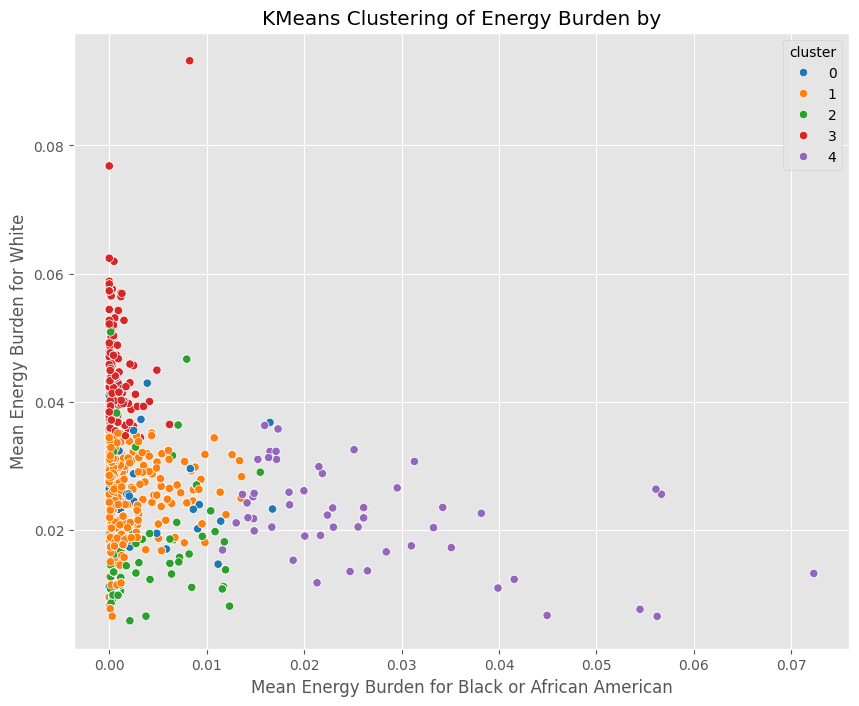

In [18]:
#implement k means clustering to see like groups of counties
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

# Create a KMeans model with 5 clusters
kmeans = KMeans(n_clusters=5)

# Create a pipeline with a StandardScaler and KMeans model
pipeline = make_pipeline(StandardScaler(), kmeans)

# Fit the pipeline to the data
pipeline.fit(env_stats[['Mean Energy Burden for Black or African American', 
                        'Mean Energy Burden for White', 'Mean Energy Burden for Hispanic or Latino', 
                        'Mean Energy Burden for Asian', 'Mean Energy Burden for American Indian/Alaska Native', 
                        'Mean Energy Burden for Native Hawaiian or Pacific']])

# Calculate the cluster labels
labels = pipeline.predict(env_stats[['Mean Energy Burden for Black or African American', 
                                     'Mean Energy Burden for White', 'Mean Energy Burden for Hispanic or Latino', 
                                     'Mean Energy Burden for Asian', 'Mean Energy Burden for American Indian/Alaska Native', 
                                     'Mean Energy Burden for Native Hawaiian or Pacific']])
# Add the labels to the DataFrame
env_stats['cluster'] = labels

# Display the DataFrame
env_stats.head()

# Plot the clusters
sns.scatterplot(data=env_stats, x='Mean Energy Burden for Black or African American', y='Mean Energy Burden for White', hue='cluster', palette='tab10')
plt.xlabel('Mean Energy Burden for Black or African American')
plt.ylabel('Mean Energy Burden for White')
plt.title('KMeans Clustering of Energy Burden by') 
plt.show()



In [19]:
from sklearn.preprocessing import MinMaxScaler
env_data = env_stats.applymap(lambda x: 1 if x is True else (0 if x is False else x))

# Normalize the columns using MinMaxScaler (scaling values between 0 and 1)
scaler = MinMaxScaler()

# Selecting the columns to scale
columns_to_scale = [
    'Energy burden',
    'Percent pre-1960s housing (lead paint indicator)',
    'PM2.5 in the air',
    'Proximity to hazardous waste sites (percentile)',
    'Share of properties at risk of flood in 30 years (percentile)',
    'Proximity to Risk Management Plan (RMP) facilities (percentile)',
    'Share of properties at risk of fire in 30 years (percentile)'
]

# Scaling the columns
env_data[columns_to_scale] = scaler.fit_transform(env_data[columns_to_scale])
                                                                                                                                                                      

# Calculating the Environmental Score by combining the scaled metrics
# Using equal weights for now; this can be adjusted based on importance
env_data['Environmental Score'] = (
    env_data['Energy burden'] +
    env_data['Percent pre-1960s housing (lead paint indicator)'] +
    env_data['PM2.5 in the air'] +
    env_data['Proximity to hazardous waste sites (percentile)'] +
    env_data['Share of properties at risk of flood in 30 years (percentile)'] +
    env_data['Proximity to Risk Management Plan (RMP) facilities (percentile)'] +
    env_data['Share of properties at risk of fire in 30 years (percentile)']
) / 7  # Dividing by 7 to average across the metrics


# Displaying the results
print(env_data[['Census tract 2010 ID', 'County Name', 'Environmental Score']])

       Census tract 2010 ID        County Name  Environmental Score
0              3.705706e+10    Davidson County             0.357643
1              4.703703e+10    Davidson County             0.397382
2              1.129044e+09  Washington County             0.451609
3              5.143011e+09  Washington County             0.405475
4              8.121924e+09  Washington County                  NaN
...                     ...                ...                  ...
11797          3.711501e+10     Madison County             0.412970
11798          3.909704e+10     Madison County             0.354139
11799          4.711300e+10     Madison County             0.368463
11800          4.831300e+10     Madison County             0.407000
11801          5.111393e+10     Madison County             0.300710

[11802 rows x 3 columns]


C:\Users\Kassidi\AppData\Local\Temp\ipykernel_31864\3779832925.py:2: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  env_data = env_stats.applymap(lambda x: 1 if x is True else (0 if x is False else x))


In [20]:
#env_stats.columns

In [21]:
#env_data.columns

In [22]:
# env_data = env_data.set_geometry('geometry')  

# census_level_environmental_map = env_data.explore(
#     column="Environmental Score",
#     scheme="naturalbreaks", 
#     legend=False, 
#     k=5, 
#     tooltip=False, 
#     popup=['County Name', 'Environmental Score'],
#     legend_kwds=dict(colorbar=False),  
#     name="Environmental Score",  
# )

# folium.TileLayer("CartoDB positron", show=False).add_to(
#     census_level_environmental_map
# )

# folium.LayerControl().add_to(census_level_environmental_map)

# census_level_environmental_map


In [23]:
from shapely.ops import unary_union

# Create a copy of the GeoDataFrame
env_stats_copy = env_data.copy()

# Use 'unary_union' to combine multiple geometries for the same county
env_stats_copy = env_stats_copy.groupby(['County Name', 'State/Territory']).agg(
    {
        'Total population': 'mean',
        'Percent American Indian / Alaska Native': 'mean',
        'Percent Asian': 'mean',
        'Percent Black or African American alone': 'mean',
        'Percent Hispanic or Latino': 'mean',
        'Percent Native Hawaiian or Pacific': 'mean',
        'Environmental Score': 'mean',
        'geometry': lambda x: unary_union(x),  # Combine multiple geometries
        'Energy burden': 'mean',
        'Energy burden (percentile)': 'mean',
        'Percent pre-1960s housing (lead paint indicator)': 'mean',
        'PM2.5 in the air': 'mean',
        'Proximity to hazardous waste sites (percentile)': 'mean',
        'Share of properties at risk of flood in 30 years (percentile)': 'mean',
        'Proximity to Risk Management Plan (RMP) facilities (percentile)': 'mean',
        'Share of properties at risk of fire in 30 years (percentile)': 'mean'
    }
).reset_index()

# Convert the dataframe back to a GeoDataFrame
env_stats_copy = gpd.GeoDataFrame(env_stats_copy)

# Check if the GeoDataFrame is correct
type(env_stats_copy)



geopandas.geodataframe.GeoDataFrame

In [24]:
county_env_map = env_stats_copy.set_geometry('geometry') 

# Create the map with the first layer (Environmental Score)
county_env_map = env_stats_copy.explore(
    column="Environmental Score",
    scheme="naturalbreaks", 
    legend=False, 
    k=5, 
    tooltip=False, 
    popup=['County Name', 'Environmental Score'],
    legend_kwds=dict(colorbar=False),  
    name="Environmental Score",  
    width="80%",  
    height="500px"  
)

# Add the tile layer to the map
folium.TileLayer("CartoDB positron", show=False).add_to(county_env_map)

# Add the second layer (Energy Burden) to the same map
env_stats_copy.explore(
    m=county_env_map,  
    column="PM2.5 in the air",
    scheme="naturalbreaks", 
    legend=False, 
    k=5, 
    tooltip=False, 
    popup=['County Name', 'PM2.5 in the air'],
    legend_kwds=dict(colorbar=False),  
    name="PM2.5 in the air",  
)

# Add a Layer Control to toggle layers
folium.LayerControl().add_to(county_env_map)

# Display the map
county_env_map


In [25]:
#save current dataframe to a csn file called env_layer.csv
env_stats_copy.to_csv('env_layer.csv')

In [26]:
# Environmental and Energy Burden layers
county_env_map = env_stats_copy.set_geometry('geometry') 

# Create the map with the first layer (Environmental Score)
county_env_map = env_stats_copy.explore(
    column="Environmental Score",
    scheme="naturalbreaks", 
    legend=False, 
    k=5, 
    tooltip=False, 
    popup=['County Name', 'Environmental Score'],
    legend_kwds=dict(colorbar=False),  
    name="Environmental Score",  
    width="80%",  
    height="500px"  
)

# Add the tile layer to the map
folium.TileLayer("CartoDB positron", show=False).add_to(county_env_map)

# Add the second layer (PM2.5 in the air) to the same map
env_stats_copy.explore(
    m=county_env_map,  
    column="PM2.5 in the air",
    scheme="naturalbreaks", 
    legend=False, 
    k=5, 
    tooltip=False, 
    popup=['County Name', 'PM2.5 in the air'],
    legend_kwds=dict(colorbar=False),  
    name="PM2.5 in the air",  
)

# Add the poverty layer (Poverty Score) to the existing map
poverty_stats_copy.explore(
    m=county_env_map,  # Pass the existing map to add the layer to it
    column="Poverty Score",
    scheme="fisherjenks", 
    cmap="Reds", 
    k=5, 
    legend=True, 
    tooltip=False,
    popup=['County Name', 'Poverty Score'],
    legend_kwds=dict(colorbar=False, label='Poverty Score', fmt="{:.2f}"), 
    name="Poverty Scores"
)

# Add a Layer Control to toggle layers
folium.LayerControl().add_to(county_env_map)

# Display the map
county_env_map


In [27]:
county_env_map.save("climate.html")
